- **Autor**: Raphael Benedeti
- **E-mail**: benedeti.raphael@gmail.com
- **Título**: O Uso De Inteligência Artificial Para Apoio À Tomada De Decisão Em Instituições Bancárias.
- **Professor** Orientador: Dr. Vinicius Costa de Souza
- **Universidade**: Universidade do Vale do Rio dos Sinos - UNISINOS
- **Data**: 20/04/2024
- **Localização**: Porto Alegre - RS

# Descrição das Colunas do DataFrame

1. **ID** - representa uma identificação única de uma entrada.
2. **Customer_ID** - representa uma identificação única de uma pessoa.
3. **Month** - representa o mês do ano.
4. **Name** - representa o nome de uma pessoa.
5. **Age** - representa a idade da pessoa.
6. **SSN** - representa o número de seguro social de uma pessoa.
7. **Occupation** - representa a ocupação da pessoa.
8. **Annual_Income** - representa a renda anual da pessoa.
9. **Monthly_Inhand_Salary** - representa o salário mensal líquido de uma pessoa.
10. **Num_Bank_Accounts** - representa o número de contas bancárias que uma pessoa possui.
11. **Num_Credit_Card** - representa o número de outros cartões de crédito que uma pessoa possui.
12. **Interest_Rate** - representa a taxa de juros do cartão de crédito.
13. **Num_of_Loan** - representa o número de empréstimos feitos pelo banco.
14. **Type_of_Loan** - representa os tipos de empréstimos feitos por uma pessoa.
15. **Delay_from_due_date** - representa o número médio de dias de atraso em relação à data de pagamento.
16. **Num_of_Delayed_Payment** - representa o número médio de pagamentos atrasados por uma pessoa.
17. **Changed_Credit_Limit** - representa a alteração percentual no limite do cartão de crédito.
18. **Num_Credit_Inquiries** - representa o número de consultas de crédito.
19. **Credit_Mix** - representa a classificação do mix de créditos.
20. **Outstanding_Debt** - representa a dívida restante a ser paga (em USD).
21. **Credit_Utilization_Ratio** - representa a proporção de utilização de crédito do cartão.
22. **Credit_History_Age** - representa a idade da história de crédito da pessoa.
23. **Payment_of_Min_Amount** - representa se apenas o valor mínimo foi pago pela pessoa.
24. **Total_EMI_per_month** - representa os pagamentos mensais de EMI (em USD).
25. **Amount_invested_monthly** - representa o valor investido mensalmente pelo cliente (em USD).
26. **Payment_Behaviour** - representa o comportamento de pagamento do cliente (em USD).
27. **Monthly_Balance** - representa o saldo mensal do cliente (em USD).
28. **Credit_Score** - representa a faixa de pontuação de crédito (Ruim, Regular, Bom).

# Preparação

## Import de Bibliotecas

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings

from sklearn.preprocessing import OneHotEncoder, LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import StandardScaler
#from sklearn.tree import DecisionTreeClassifier
#from sklearn.ensemble import RandomForestClassifier
#from sklearn.linear_model import LogisticRegression
#from sklearn.neighbors import KNeighborsClassifier
#from sklearn.svm import SVC
from yellowbrick.classifier import ConfusionMatrix

warnings.filterwarnings("ignore")
pd.set_option("display.max_columns", None)

## Funções utilizadas

In [2]:
def create_confusion_matrix(model):
    # Calcula a matriz de confusão
    cm = ConfusionMatrix(model)
    cm.fit(X_treino, Y_treino)

    # Calcula o score
    value_score = cm.score(X_teste, Y_teste)
    percentage = value_score * 100
    
    print("================================================================")
    # Título do relatório
    print(f"Relatório de Avaliação do Modelo:  {model.__class__.__name__}")
    print("================================================================")

    print("\n")
    # Apresenta o percentual de acurácia
    print("================================================================")
    print(f"Percentual de acurácia:  {percentage:.2f}%")
    print("================================================================")
    

    print("\n")
    print("================================================================")
    # Apresenta o relatório de classificação
    print("Relatório de Classificação:\n\n")
    previsoes = model.predict(X_teste)
    print(classification_report(Y_teste, previsoes))
    print("================================================================")


In [3]:
def clean_column(df:pd.DataFrame, col:str, is_int:bool, characters:list=None):
    if characters is not None: 
        for crtr in characters:
            if crtr == "":
                df[col] = df[col].str.replace('_', '999999999999999999999999999')
                df[col] = df[col].replace('999999999999999999999999999', '')
                df[col].replace('', np.nan, inplace=True)
                df[col] = df[col].astype(float)
                df[col] = df[col].fillna(df[col].mean())         
            else:
                df[col] = df[col].str.replace(crtr, "")
        df[col] = df[col].astype(float)
        df[col] = df[col].fillna(df[col].mean())
        if is_int is True:
            df[col] = df[col].astype(int)
        else:
            pass
        print(f"⮕ Remoção dos caracteres: {characters} na coluna: {col}\n")
    elif characters is None:
        print(f"⮕ Coluna: {col} para float\n")
        df[col] = df[col].astype(float)
        df[col] = df[col].fillna(df[col].mean())

In [4]:
def parse_years_and_months(age) -> int:
    if isinstance(age, str):
        age_parts = age.split(" Years and ")
        years = int(age_parts[0]) if "Years" in age else 0 
        months_str = age_parts[1].split(" Months")[0] if "Months" in age_parts[1] else "0" 
        months = int(months_str)
        total_months = years * 12 + months
        return total_months
    else:
        return 0

In [5]:
def remove_outliers(df:pd.DataFrame, cols:list):
    new_data = df.copy()
    for col in cols:
        q1, q3 = np.percentile(new_data[col], [25,75])
        iqr = q3 - q1
        lower_bound = q1 - (1.5 * iqr)
        upper_bound = q3 + (1.5 * iqr)
        outliers_mask = (new_data[col] < lower_bound) | (new_data[col] > upper_bound)
        new_data = new_data[~outliers_mask]
    return new_data

In [6]:
def scatter_outliers(df:pd.DataFrame, cols:list, x_col=str, col_color=str):
    for i in range(len(cols)):
        y_col = cols[i]
        if y_col != x_col:
            grafico = px.scatter(df, x=x_col, y=y_col, color=col_color)
            grafico.show(width=800, height=600)

## Leitura dos Dados

In [7]:
# https://www.kaggle.com/datasets/parisrohan/credit-score-classification
df_train = pd.read_csv("train.csv")

In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

# Tratamento dos dados

## Ajustando o tipo do dado

In [9]:
cols = ["Credit_Score"
        , "Changed_Credit_Limit"
        , "Outstanding_Debt"
        , "Amount_invested_monthly"
        , "Annual_Income"
        , "Monthly_Balance"
        , "Age"
        , "Num_of_Delayed_Payment"
        , "Num_of_Loan"
        , "Num_Credit_Inquiries"
        , "Monthly_Inhand_Salary"
        ]

In [10]:
dict = {
    "Good": "Bom"
    ,"Standard": "Regular"
    ,"Poor": "Ruim"
}
df_train["Credit_Score"] = df_train["Credit_Score"].map(dict)

In [11]:
df_train["Credit_History_Age_Months"] = df_train["Credit_History_Age"].apply(parse_years_and_months)

In [12]:
df_train[cols].head(30)

,Credit_Score,Changed_Credit_Limit,Outstanding_Debt,Amount_invested_monthly,Annual_Income,Monthly_Balance,Age,Num_of_Delayed_Payment,Num_of_Loan,Num_Credit_Inquiries,Monthly_Inhand_Salary
0,Bom,11.27,809.98,80.41529543900253,19114.12,312.49408867943663,23,7,4,4.0,1824.843333
1,Bom,11.27,809.98,118.28022162236736,19114.12,284.62916249607184,23,NaN,4,4.0,NaN
2,Bom,_,809.98,81.699521264648,19114.12,331.2098628537912,-500,7,4,4.0,NaN
3,Bom,6.27,809.98,199.4580743910713,19114.12,223.45130972736786,23,4,4,4.0,NaN
4,Bom,11.27,809.98,41.420153086217326,19114.12,341.48923103222177,23,NaN,4,4.0,1824.843333
5,Bom,9.27,809.98,62.430172331195294,19114.12,340.4792117872438,23,4,4,4.0,NaN
6,Bom,11.27,809.98,178.3440674122349,19114.12,244.5653167062043,23,8_,4,4.0,1824.843333
7,Regular,11.27,809.98,24.785216509052056,19114.12,358.12416760938714,23,6,4,4.0,1824.843333
8,Regular,5.42,605.03,104.291825168246,34847.84,470.69062692529184,28_,4,1,2.0,3037.986667
9,Bom,7.42,605.03,40.39123782853101,34847.84,484.5912142650067,28,1,1,2.0,3037.986667


In [13]:
clean_column(df=df_train, col="Changed_Credit_Limit", is_int=False, characters=["-", "_", ""])

clean_column(df=df_train, col="Outstanding_Debt", is_int=False, characters=["-", "_"])
clean_column(df=df_train, col="Annual_Income", is_int=False, characters=["-", "_"])
clean_column(df=df_train, col="Monthly_Balance", is_int=False, characters=["-", "_"])
clean_column(df=df_train, col="Amount_invested_monthly", is_int=False, characters=["_","-"])
clean_column(df=df_train, col="Age", is_int=True, characters=["_","-"])
clean_column(df=df_train, col="Num_of_Delayed_Payment", is_int=True, characters=["_", "-"])
clean_column(df=df_train, col="Num_of_Loan", is_int=True, characters=["_", "-"])

clean_column(df=df_train, col="Num_Credit_Inquiries", is_int=False, characters=None)
clean_column(df=df_train, col="Monthly_Inhand_Salary", is_int=False, characters=None)

⮕ Remoção dos caracteres: ['-', '_', ''] na coluna: Changed_Credit_Limit

⮕ Remoção dos caracteres: ['-', '_'] na coluna: Outstanding_Debt

⮕ Remoção dos caracteres: ['-', '_'] na coluna: Annual_Income

⮕ Remoção dos caracteres: ['-', '_'] na coluna: Monthly_Balance

⮕ Remoção dos caracteres: ['_', '-'] na coluna: Amount_invested_monthly

⮕ Remoção dos caracteres: ['_', '-'] na coluna: Age

⮕ Remoção dos caracteres: ['_', '-'] na coluna: Num_of_Delayed_Payment

⮕ Remoção dos caracteres: ['_', '-'] na coluna: Num_of_Loan

⮕ Coluna: Num_Credit_Inquiries para float

⮕ Coluna: Monthly_Inhand_Salary para float



In [14]:
df_train[cols].head(30)

,Credit_Score,Changed_Credit_Limit,Outstanding_Debt,Amount_invested_monthly,Annual_Income,Monthly_Balance,Age,Num_of_Delayed_Payment,Num_of_Loan,Num_Credit_Inquiries,Monthly_Inhand_Salary
0,Bom,11.270000,809.98,80.415295,19114.12,312.494089,23,7,4,4.000000,1824.843333
1,Bom,11.270000,809.98,118.280222,19114.12,284.629162,23,30,4,4.000000,4194.170850
2,Bom,10.465678,809.98,81.699521,19114.12,331.209863,500,7,4,4.000000,4194.170850
3,Bom,6.270000,809.98,199.458074,19114.12,223.451310,23,4,4,4.000000,4194.170850
4,Bom,11.270000,809.98,41.420153,19114.12,341.489231,23,30,4,4.000000,1824.843333
5,Bom,9.270000,809.98,62.430172,19114.12,340.479212,23,4,4,4.000000,4194.170850
6,Bom,11.270000,809.98,178.344067,19114.12,244.565317,23,8,4,4.000000,1824.843333
7,Regular,11.270000,809.98,24.785217,19114.12,358.124168,23,6,4,4.000000,1824.843333
8,Regular,5.420000,605.03,104.291825,34847.84,470.690627,28,4,1,2.000000,3037.986667
9,Bom,7.420000,605.03,40.391238,34847.84,484.591214,28,1,1,2.000000,3037.986667


## Remoção de Colunas

In [15]:
colunas_sem_valor = ["ID" 
                     ,"Customer_ID"
                     ,"Month"
                     ,"Name"
                     ,"SSN"
                     ,"Type_of_Loan"
                     ,"Credit_History_Age"]

In [16]:
df_train[colunas_sem_valor].head(10)

,ID,Customer_ID,Month,Name,SSN,Type_of_Loan,Credit_History_Age
0,0x1602,CUS_0xd40,January,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 1 Months
1,0x1603,CUS_0xd40,February,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",NaN
2,0x1604,CUS_0xd40,March,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 3 Months
3,0x1605,CUS_0xd40,April,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 4 Months
4,0x1606,CUS_0xd40,May,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 5 Months
5,0x1607,CUS_0xd40,June,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 6 Months
6,0x1608,CUS_0xd40,July,Aaron Maashoh,821-00-0265,"Auto Loan, Credit-Builder Loan, Personal Loan,...",22 Years and 7 Months
7,0x1609,CUS_0xd40,August,NaN,#F%$D@*&8,"Auto Loan, Credit-Builder Loan, Personal Loan,...",NaN
8,0x160e,CUS_0x21b1,January,Rick Rothackerj,004-07-5839,Credit-Builder Loan,26 Years and 7 Months
9,0x160f,CUS_0x21b1,February,Rick Rothackerj,004-07-5839,Credit-Builder Loan,26 Years and 8 Months


In [17]:
df_train = df_train.drop(colunas_sem_valor, axis = 1)
print(f"⮕ Colunas: {colunas_sem_valor} removidas com sucesso ✓✓✓")

⮕ Colunas: ['ID', 'Customer_ID', 'Month', 'Name', 'SSN', 'Type_of_Loan', 'Credit_History_Age'] removidas com sucesso ✓✓✓


In [18]:
df_train.head(10)

,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_History_Age_Months
0,23,Scientist,19114.12,1824.843333,3,4,3,4,3,7,11.270000,4.0,_,809.98,26.822620,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,Bom,265
1,23,Scientist,19114.12,4194.170850,3,4,3,4,-1,30,11.270000,4.0,Good,809.98,31.944960,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,Bom,0
2,500,Scientist,19114.12,4194.170850,3,4,3,4,3,7,10.465678,4.0,Good,809.98,28.609352,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.209863,Bom,267
3,23,Scientist,19114.12,4194.170850,3,4,3,4,5,4,6.270000,4.0,Good,809.98,31.377862,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,Bom,268
4,23,Scientist,19114.12,1824.843333,3,4,3,4,6,30,11.270000,4.0,Good,809.98,24.797347,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489231,Bom,269
5,23,Scientist,19114.12,4194.170850,3,4,3,4,8,4,9.270000,4.0,Good,809.98,27.262259,No,49.574949,62.430172,!@9#%8,340.479212,Bom,270
6,23,Scientist,19114.12,1824.843333,3,4,3,4,3,8,11.270000,4.0,Good,809.98,22.537593,No,49.574949,178.344067,Low_spent_Small_value_payments,244.565317,Bom,271
7,23,Scientist,19114.12,1824.843333,3,4,3,4,3,6,11.270000,4.0,Good,809.98,23.933795,No,49.574949,24.785217,High_spent_Medium_value_payments,358.124168,Regular,0
8,28,_______,34847.84,3037.986667,2,4,6,1,3,4,5.420000,2.0,Good,605.03,24.464031,No,18.816215,104.291825,Low_spent_Small_value_payments,470.690627,Regular,319
9,28,Teacher,34847.84,3037.986667,2,4,6,1,7,1,7.420000,2.0,Good,605.03,38.550848,No,18.816215,40.391238,High_spent_Large_value_payments,484.591214,Bom,320


## Removendo outliers com IQR

In [19]:
cols = [
    "Age"
    ,"Num_Bank_Accounts"
    ,"Num_Credit_Card"
    ,"Interest_Rate"
    ,"Num_of_Loan"
    ,"Num_of_Delayed_Payment"
    ,"Num_Credit_Inquiries"
    ,"Changed_Credit_Limit"
]

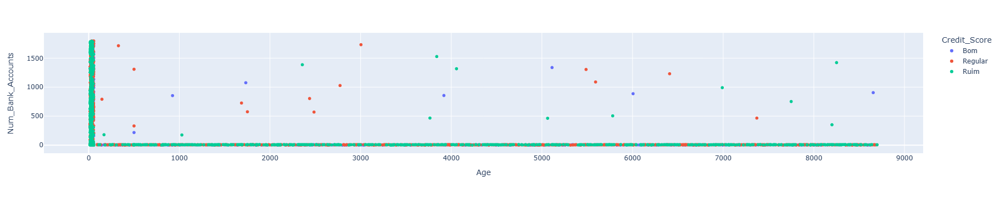

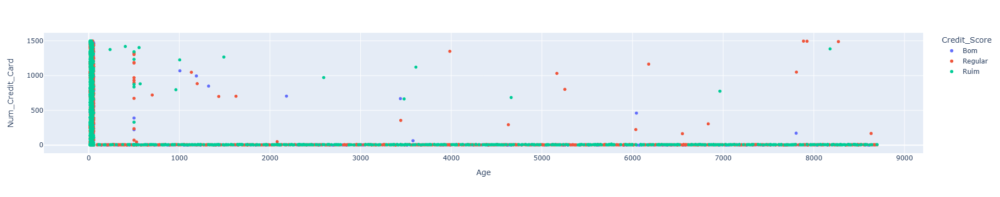

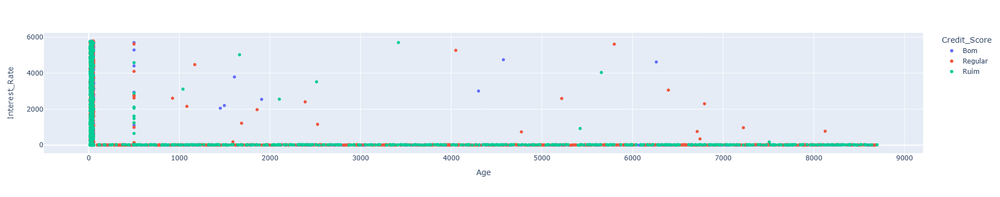

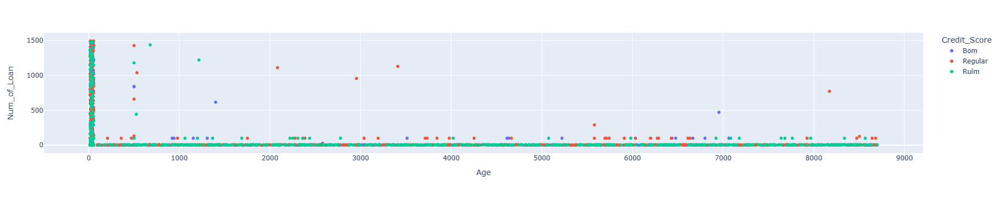

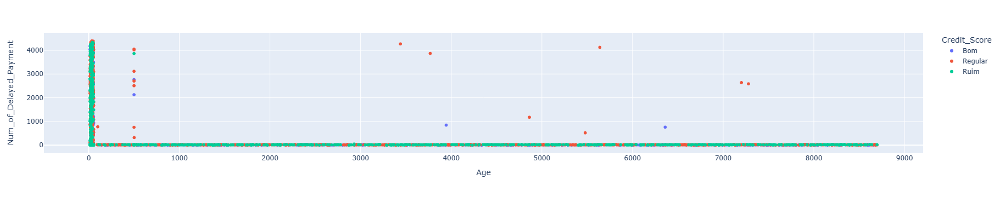

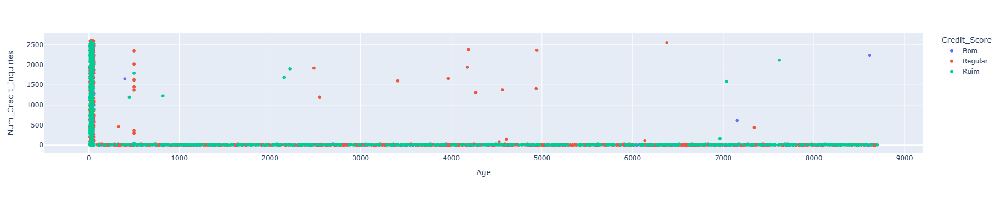

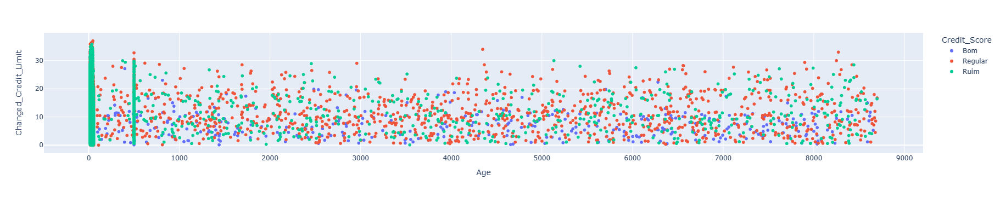

In [20]:
scatter_outliers(df=df_train, cols=cols, x_col="Age", col_color="Credit_Score")

In [21]:
print("--------------------------------------")
print("Antes da remoção dos outliers")
for col in cols:
    print(f"{col}:  {len(df_train[col])}")
print("--------------------------------------")

--------------------------------------
Antes da remoção dos outliers
Age:  100000
Num_Bank_Accounts:  100000
Num_Credit_Card:  100000
Interest_Rate:  100000
Num_of_Loan:  100000
Num_of_Delayed_Payment:  100000
Num_Credit_Inquiries:  100000
Changed_Credit_Limit:  100000
--------------------------------------


In [22]:
df_finish = remove_outliers(df=df_train, cols=cols)

In [23]:
print("--------------------------------------")
print("Depois da remoção dos outliers")
for col in cols:
    print(f"{col}:  {len(df_finish[col])}")
print("--------------------------------------")

--------------------------------------
Depois da remoção dos outliers
Age:  83065
Num_Bank_Accounts:  83065
Num_Credit_Card:  83065
Interest_Rate:  83065
Num_of_Loan:  83065
Num_of_Delayed_Payment:  83065
Num_Credit_Inquiries:  83065
Changed_Credit_Limit:  83065
--------------------------------------


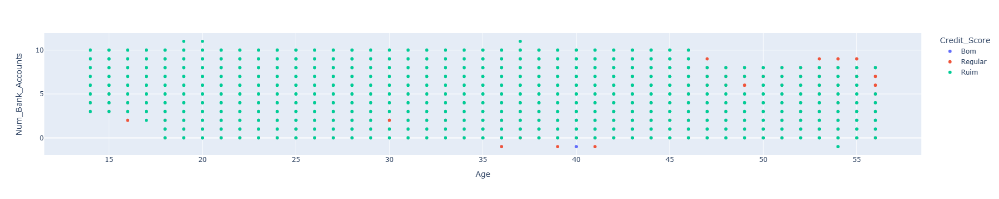

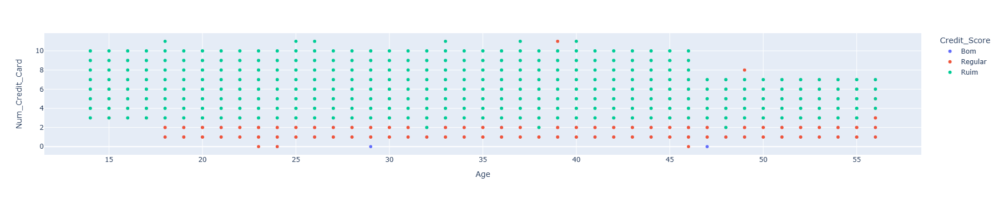

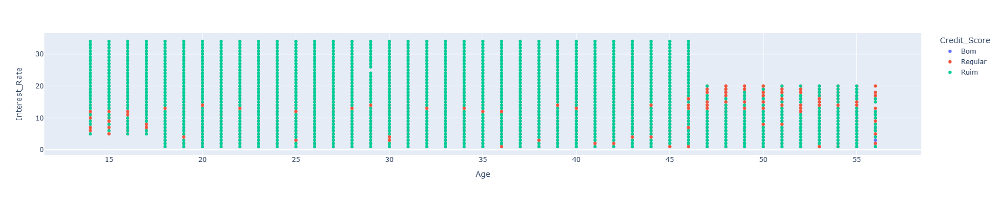

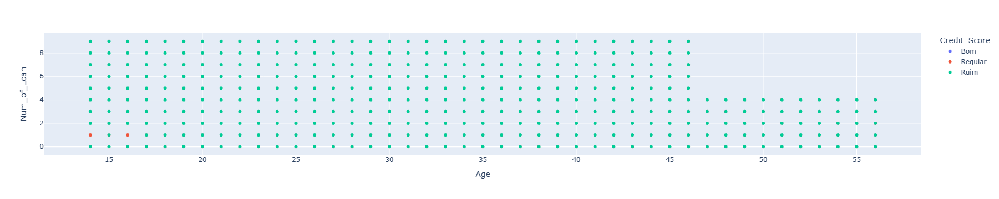

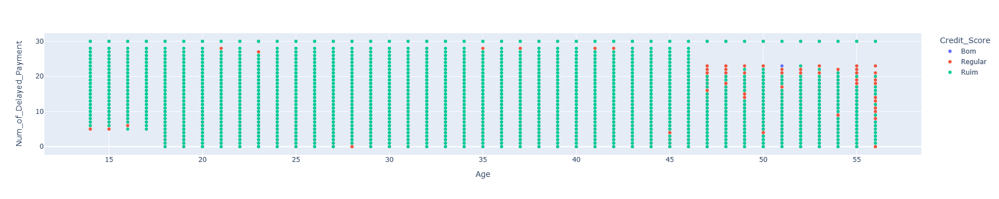

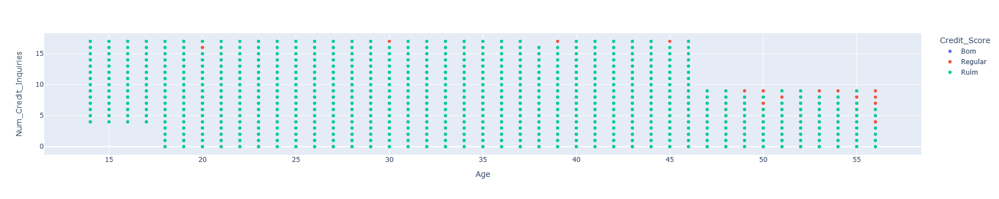

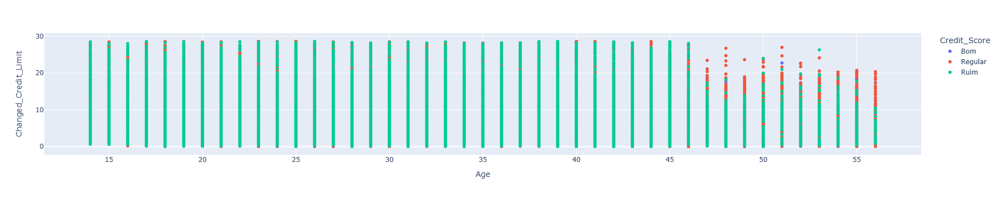

In [24]:
scatter_outliers(df=df_finish, cols=cols, x_col="Age", col_color="Credit_Score")

# Divisão entre variável Feature & Target

## Previsor

In [25]:
X_credit_score = df_finish.drop("Credit_Score", axis=1)

In [26]:
X_credit_score.head(3)

,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_History_Age_Months
0,23,Scientist,19114.12,1824.843333,3,4,3,4,3,7,11.27,4.0,_,809.98,26.822620,No,49.574949,80.415295,High_spent_Small_value_payments,312.494089,265
1,23,Scientist,19114.12,4194.170850,3,4,3,4,-1,30,11.27,4.0,Good,809.98,31.944960,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629162,0
3,23,Scientist,19114.12,4194.170850,3,4,3,4,5,4,6.27,4.0,Good,809.98,31.377862,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451310,268


## Classe

In [27]:
Y_credit_score = df_finish["Credit_Score"]

In [28]:
Y_credit_score.head(3)

0    Bom
1    Bom
3    Bom
Name: Credit_Score, dtype: object

# Enconding

## Label Enconder

In [29]:
lista_colunas = []
for nome_coluna in X_credit_score:
    if X_credit_score[nome_coluna].dtype == "object":
            lista_colunas.append(nome_coluna)
print(f"⮕ As colunas que receberão o Label Enconder são: {lista_colunas}")

⮕ As colunas que receberão o Label Enconder são: ['Occupation', 'Credit_Mix', 'Payment_of_Min_Amount', 'Payment_Behaviour']


In [30]:
X_credit_score[lista_colunas].head(5)

,Occupation,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour
0,Scientist,_,No,High_spent_Small_value_payments
1,Scientist,Good,No,Low_spent_Large_value_payments
3,Scientist,Good,No,Low_spent_Small_value_payments
4,Scientist,Good,No,High_spent_Medium_value_payments
5,Scientist,Good,No,!@9#%8


In [31]:
label_encoder = LabelEncoder()
for col in lista_colunas:
    X_credit_score[col] = label_encoder.fit_transform(X_credit_score[col])
    print(f"⮕ Coluna: {col} com Label Enconder realizado com sucesso ✓✓✓")

⮕ Coluna: Occupation com Label Enconder realizado com sucesso ✓✓✓
⮕ Coluna: Credit_Mix com Label Enconder realizado com sucesso ✓✓✓
⮕ Coluna: Payment_of_Min_Amount com Label Enconder realizado com sucesso ✓✓✓
⮕ Coluna: Payment_Behaviour com Label Enconder realizado com sucesso ✓✓✓


In [32]:
X_credit_score[lista_colunas].head(5)

,Occupation,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour
0,12,3,1,3
1,12,1,1,4
3,12,1,1,6
4,12,1,1,2
5,12,1,1,0


## Standard Scaler

In [33]:
stand_scaler = StandardScaler()
X_credit_score = stand_scaler.fit_transform(X_credit_score)

In [34]:
X_credit_score

array([[-9.56616649e-01,  9.61473645e-01, -1.10511705e-01, ...,
        -2.29390186e-01, -1.06635432e-02,  5.48248564e-01],
       [-9.56616649e-01,  9.61473645e-01, -1.10511705e-01, ...,
         2.62346267e-01, -1.06635432e-02, -1.77271285e+00],
       [-9.56616649e-01,  9.61473645e-01, -1.10511705e-01, ...,
         1.24581917e+00, -1.06635432e-02,  5.74523599e-01],
       ...,
       [-7.71386632e-01,  3.15210179e-01, -9.61690434e-02, ...,
        -7.21126640e-01, -1.76144960e-03,  1.54669989e+00],
       [-7.71386632e-01,  3.15210179e-01, -9.61690434e-02, ...,
         2.62346267e-01, -1.76144960e-03,  1.56421658e+00],
       [-7.71386632e-01,  3.15210179e-01, -9.61690434e-02, ...,
        -1.70459955e+00, -1.76144960e-03,  1.57297492e+00]])

# Divisão entre variáveis de teste & de treinamento

In [35]:
X_treino, X_teste, Y_treino, Y_teste = train_test_split(X_credit_score, Y_credit_score, test_size = 0.2, random_state = 7)

print(f"⮕ Quantidade de registros de treino: {len(X_treino)}")
print(f"⮕ Quantidade de registros de teste: {len(X_teste)}")

⮕ Quantidade de registros de treino: 66452
⮕ Quantidade de registros de teste: 16613


# Modelos

## Árvore de Decisão - 69.02%

In [36]:
from sklearn.tree import DecisionTreeClassifier

In [37]:
decision_tree_classifier = DecisionTreeClassifier(criterion="entropy", random_state = 0)
decision_tree_classifier.fit(X_treino, Y_treino)

DecisionTreeClassifier(criterion='entropy', random_state=0)

Relatório de Avaliação do Modelo:  DecisionTreeClassifier


Percentual de acurácia:  69.02%


Relatório de Classificação:


              precision    recall  f1-score   support

         Bom       0.61      0.62      0.61      2996
     Regular       0.73      0.72      0.72      8834
        Ruim       0.68      0.68      0.68      4783

    accuracy                           0.69     16613
   macro avg       0.67      0.67      0.67     16613
weighted avg       0.69      0.69      0.69     16613



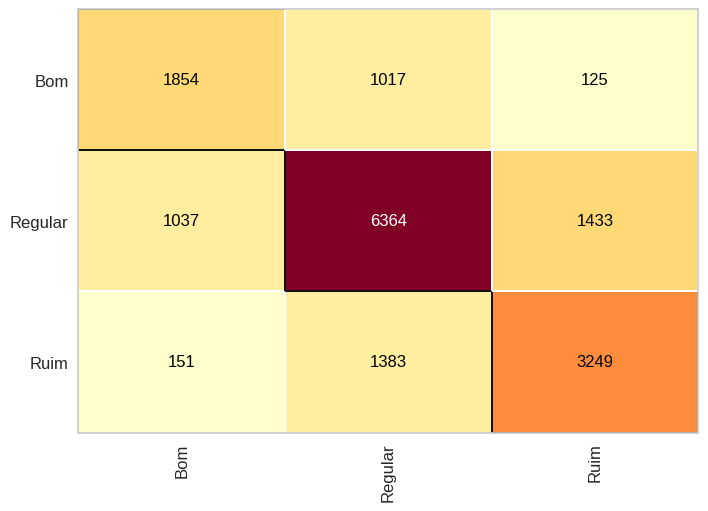

In [38]:
create_confusion_matrix(model=decision_tree_classifier)

## Floresta Aleatória (RF) - 79.08%

In [39]:
from sklearn.ensemble import RandomForestClassifier

In [40]:
random_forest_classifier = RandomForestClassifier(n_estimators=77)
random_forest_classifier.fit(X_treino, Y_treino)

RandomForestClassifier(n_estimators=77)

Relatório de Avaliação do Modelo:  RandomForestClassifier


Percentual de acurácia:  79.08%


Relatório de Classificação:


              precision    recall  f1-score   support

         Bom       0.74      0.73      0.74      2996
     Regular       0.81      0.81      0.81      8834
        Ruim       0.79      0.80      0.79      4783

    accuracy                           0.79     16613
   macro avg       0.78      0.78      0.78     16613
weighted avg       0.79      0.79      0.79     16613



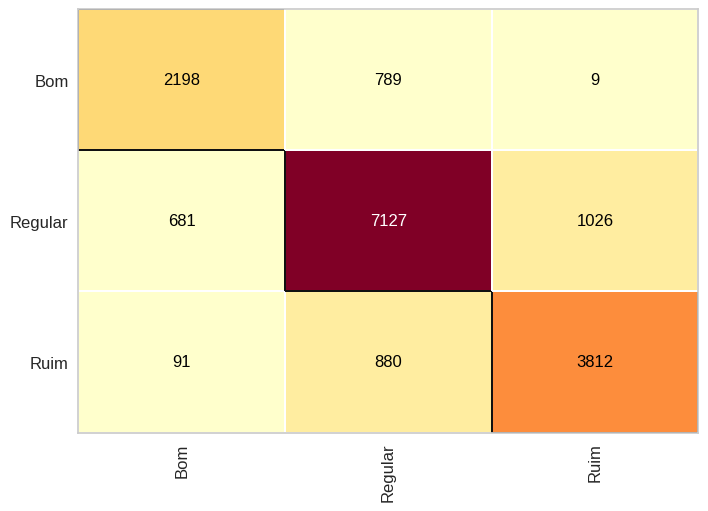

In [41]:
create_confusion_matrix(model=random_forest_classifier)

## Regressão Logística - 64.56%

In [42]:
from sklearn.linear_model import LogisticRegression

In [43]:
logistic_regression = LogisticRegression(random_state = 1)
logistic_regression.fit(X_treino, Y_treino)

LogisticRegression(random_state=1)

Relatório de Avaliação do Modelo:  LogisticRegression


Percentual de acurácia:  64.56%


Relatório de Classificação:


              precision    recall  f1-score   support

         Bom       0.58      0.44      0.50      2996
     Regular       0.65      0.78      0.71      8834
        Ruim       0.67      0.52      0.59      4783

    accuracy                           0.65     16613
   macro avg       0.63      0.58      0.60     16613
weighted avg       0.64      0.65      0.64     16613



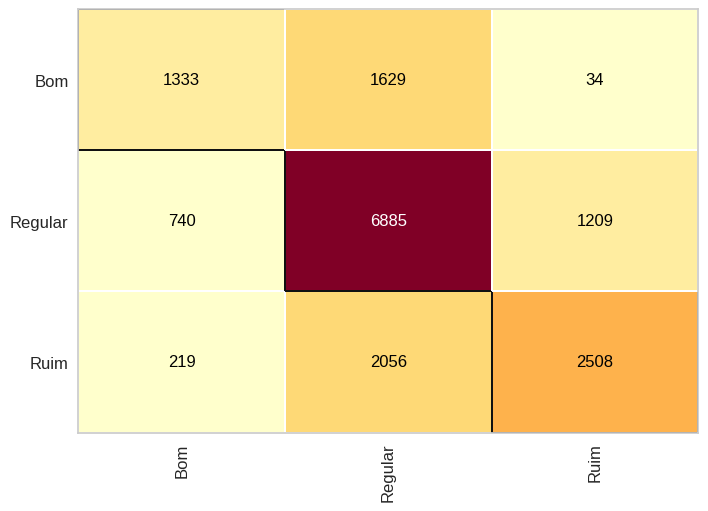

In [44]:
create_confusion_matrix(model=logistic_regression)

## Vizinhos Mais Próximos (KNN) - 66.59%

In [45]:
from sklearn.neighbors import KNeighborsClassifier

In [46]:
knn = KNeighborsClassifier(n_neighbors = 4)
knn.fit(X_treino, Y_treino)

KNeighborsClassifier(n_neighbors=4)

Relatório de Avaliação do Modelo:  KNeighborsClassifier


Percentual de acurácia:  66.59%


Relatório de Classificação:


              precision    recall  f1-score   support

         Bom       0.54      0.62      0.58      2996
     Regular       0.70      0.76      0.72      8834
        Ruim       0.71      0.53      0.61      4783

    accuracy                           0.67     16613
   macro avg       0.65      0.64      0.64     16613
weighted avg       0.67      0.67      0.66     16613



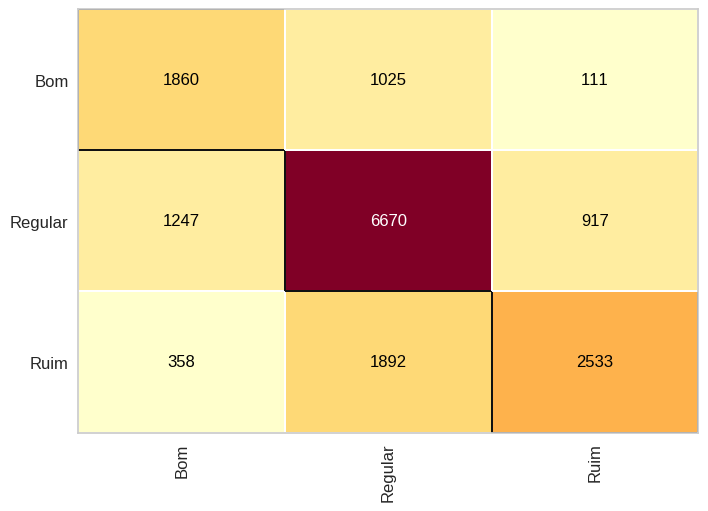

In [47]:
create_confusion_matrix(model=knn)

## Máquina de Vetores de Suporte (SVM) - 69.92%

In [48]:
from sklearn.svm import SVC
svm = SVC(kernel='rbf', random_state=1, C = 2.0)
svm.fit(X_treino, Y_treino)

SVC(C=2.0, random_state=1)

Relatório de Avaliação do Modelo:  SVC


Percentual de acurácia:  69.79%


Relatório de Classificação:


              precision    recall  f1-score   support

         Bom       0.55      0.66      0.60      2996
     Regular       0.74      0.75      0.74      8834
        Ruim       0.74      0.62      0.68      4783

    accuracy                           0.70     16613
   macro avg       0.68      0.68      0.67     16613
weighted avg       0.70      0.70      0.70     16613



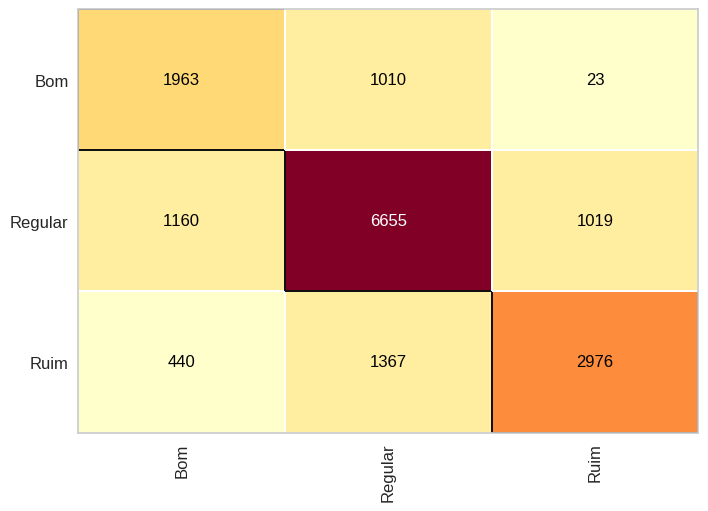

In [49]:
create_confusion_matrix(model=svm)